In [2]:
import pypsa
import openpyxl
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
import matplotlib.patches as mpatches

In [3]:
tech_colors= {
    'onwind': "#235ebc",
    'onshore wind': "#235ebc",
    'offwind': "#6895dd",
    'offshore wind': "#6895dd",
    'offwind-ac': "#6895dd",
    'offshore wind (AC)': "#6895dd",
    'offwind-dc': "#74c6f2",
    'offshore wind (DC)': "#74c6f2",
    'hydro': '#298c81',
    'hydro reservoir': '#298c81',
    'ror': '#3dbfb0',
    'run of river': '#3dbfb0',
    'hydroelectricity': '#298c81',
    'PHS': '#51dbcc',
    'wave': '#a7d4cf',
    'solar': "#f9d002",
    'solar utility': "#f9d002",
    'solar PV': "#f9d002",
    'solar thermal': '#ffbf2b',
    'solar rooftop': 'orange',
        'solar distributed': 'orange',
    'OCGT': '#e0986c',
    'gas': '#e05b09',
    'fossil gas': '#e05b09',
    'natural gas': '#e05b09',
    'CCGT': '#a85522',
    'Nuclear': '#ff8c00',
    'Nuclear marginal': '#ff8c00',
    'nuclear': 'brown',
    'uranium': '#ff8c00',
    'battery discharger': '#ace37f',
    'utility battery charger': '#ace37f',
    'battery charger': '#ace37f',
    'utility battery discharger': '#ace37f',
    'home battery charger': '#80c944',
    'home battery discharger': '#80c944',
    'distributed battery charger': '#80c944',
    'distributed battery discharger': '#80c944',
    'hydrogen': '#bf13a0',
    'SMR': '#870c71',
    'SMR CC': '#4f1745',
    'H2 Fuel Cell': '#c251ae',
    'H2 Electrolysis': '#ff29d9',
    'electricity distribution grid': 'grey',
    'electricity': 'black',
    'hydrogen': 'red',
    'methane' : '#870c71',
     'oil' : '#a7d4cf',
    'p_nom_opt' : '#870c71',
     'p_nom_max' : '#a7d4cf',
    'transmission' : 'darkgrey',
    'other high voltage' :'grey',

    
}

In [3]:
#figure 7
def nodal_balance(n, carrier, time=slice(None), aggregate=None, energy=True):

    if not isinstance(carrier, list):
        carrier = [carrier]

    one_port_data = {}

    for c in n.iterate_components(n.one_port_components):

        df = c.df[c.df.bus.map(n.buses.carrier).isin(carrier)]

        if df.empty:
            continue

        s = c.pnl.p.loc[time, df.index] * df.sign

        s = s.groupby([df.bus.map(n.buses.location), df.carrier], axis=1).sum()

        one_port_data[c.list_name] = s

    branch_data = {}

    for c in n.iterate_components(n.branch_components):
        for col in c.df.columns[c.df.columns.str.startswith("bus")]:

            end = col[3:]

            df = c.df[c.df[col].map(n.buses.carrier).isin(carrier)]

            if df.empty:
                continue

            s = -c.pnl[f"p{end}"].loc[time, df.index]

            s = s.groupby([df[col].map(n.buses.location), df.carrier], axis=1).sum()

            branch_data[(c.list_name, end)] = s

    branch_balance = pd.concat(branch_data).groupby(level=[0, 2]).sum()
    one_port_balance = pd.concat(one_port_data)

    def skip_tiny(df, threshold=1e-1):
        return df.where(df.abs() > threshold)

    branch_balance = skip_tiny(branch_balance)
    one_port_balance = skip_tiny(one_port_balance)

    balance = pd.concat([one_port_balance, branch_balance]).stack(level=[0, 1])

    balance.index.set_names(["component", "bus"], level=[0, 2], inplace=True)

    if energy:
        balance = balance * n.snapshot_weightings.generators

    if aggregate is not None:
        keep_levels = balance.index.names.difference(aggregate)
        balance = balance.groupby(level=keep_levels).sum()

    return balance

In [4]:
def plot_imbalance_rate(
    s,
    geodf,
    carrier,
    label="",
    cmap="PiYG",
    limit="symmetric",
    vmax=None,
    vmin=None,
    fn=True,
):
    proj = ccrs.EqualEarth()
    geodf = geodf.to_crs(proj.proj4_init)

    fig, ax = plt.subplots(figsize=(7, 7), subplot_kw={"projection": proj})

    if limit == "symmetric":
        lim = max(s.max(), s.min())
        vmin = -lim
        vmax = lim

    geodf.plot(
        ax=ax,
        column=s.reindex(geodf.index),
        # transform=ccrs.PlateCarree(),
        cmap=cmap,
        linewidths=0,
        legend=True,
        vmax=vmax,
        vmin=vmin,
        legend_kwds={
            "label": label,
            "shrink": 0.7,
            "extend": "both",
        },
    )

    ax.add_feature(cartopy.feature.COASTLINE.with_scale("50m"), linewidth=0.2, zorder=2)
    ax.add_feature(cartopy.feature.BORDERS.with_scale("50m"), linewidth=0.2, zorder=2)

    plt.gca().outline_patch.set_visible(False)
    ax.set_facecolor("white")

    #if fn:
     #   if not isinstance(fn, str):
      #      fn = f"{OUTPUT_SCENARIO}/imbalance-rate-{carrier}.pdf"
       # plt.savefig(fn, bbox_inches="tight")
        #plt.close()


In [5]:
def get_import_export_balance(n, time=slice(None) ,):

    io = pd.DataFrame()
    
    unique_link_carriers = n.links.carrier.unique()
    INDUSTRY = "gas for industry" in unique_link_carriers

    if INDUSTRY:    #oil and gas balance only for sector-coupled
      io["oil"] = get_import_export_oil(with_methanol).eval("demand - supply")

    ac_balance = nodal_balance(n, "AC", time=time, aggregate=["snapshot"], energy=True)  #needs to be defined before H2 and energy=True
    io["electricity"] = (
        ac_balance.droplevel(0).unstack("carrier")[["AC", "DC"]].sum(axis=1).div(1e6)
    )
    
    
    h2_balance = nodal_balance(n, "H2", time=time, aggregate=["snapshot"])
    io["hydrogen"] = (
        h2_balance.droplevel(0)
        .unstack("carrier")
        .filter(like="H2 pipeline")
        .sum(axis=1)
    ).div(1e6)


    
    GAS_NETWORK = "gas pipeline" in unique_link_carriers
    if GAS_NETWORK:
        gas_balance = nodal_balance(n, "gas", aggregate=["snapshot"])

        io["gas"] = (
            gas_balance.groupby(["bus", "carrier"])
            .sum()
            .unstack()
            .filter(like="gas pipeline")
            .sum(axis=1)
            .div(1e6)
        )

    elif INDUSTRY:
        io["gas"] = get_import_export_gas().eval("demand - supply")

    io["total"] = io.sum(axis=1)

    return io.fillna(0.0)

In [6]:
import matplotlib.colors as mplcolors

def plot_import_export(
    df,
    geodf,
    carrier,
    cmap="PiYG",
    unit="TWh",
    fn=True,
    lim=None,
    lorenz=False,
    dfs={},
):

    crs = ccrs.EqualEarth()
    geodf = geodf.to_crs(crs.proj4_init)

    if lim is None:
        lim = df[carrier].abs().max()
        
    #norm = mplcolors.SymLogNorm(linthresh=5, linscale=1,   vmin=-lim, vmax=lim, base=10)
    
    #norm=mplcolors.colors.LogNorm(vmin=-lim, vmax=lim)                            
    #norm= mplcolors.PowerNorm(gamma=0.5)
    
    bounds = np.linspace(-lim, lim, 9)
    
    #num=4
    #bounds = np.logspace(np.log10(5), np.log10(lim), base=10, num=num)
    #bounds=np.insert(bounds,0, (-1)*np.flip(bounds))
    #bounds= np.insert(bounds, num, 0)
    norm = mplcolors.BoundaryNorm(boundaries=bounds, ncolors=256)
    print(bounds)
    fig, ax = plt.subplots(figsize=(7, 7), subplot_kw={"projection": crs})  #7, 7

    geodf.plot(
        ax=ax,
        column=-df[carrier].reindex(geodf.index),
        cmap=cmap,
        norm=norm,   ###
        linewidths=0,
        legend=True,
        ##vmin=-lim,
        ##vmax=lim,
        legend_kwds={
            "label": f"{carrier} balance [{unit}]",
            "shrink": 0.7,
        },
    )

    ax.add_feature(cartopy.feature.COASTLINE.with_scale("50m"), linewidth=0.2, zorder=2)
    ax.add_feature(cartopy.feature.BORDERS.with_scale("50m"), linewidth=0.2, zorder=2)

    plt.gca().outline_patch.set_visible(False)
    ax.set_facecolor("white")

    if lorenz:
        axins = ax.inset_axes([0.05, 0.77, 0.27, 0.23])
        carriers = ["AC"] #, "H2", "gas", "oil"]  # if GAS_NETWORK else ["AC", "H2"]
        plot_lorenz_inset(axins, n, carriers, dfs=dfs)

    #if fn:
     #   if not isinstance(fn, str):
      #      fn = f"{OUTPUT_SCENARIO}/import-export-{carrier}-{lim}.pdf"
       # plt.savefig(fn, bbox_inches="tight")
        #plt.close()

In [7]:
def cumulative_share(n, carrier, sortby="supply/demand", df=None):

    if df is None:

        to_drop = [
            "AC",
            "DC",
            "H2 pipeline",
            "gas pipeline",
            "gas pipeline new",
            "H2 pipeline retrofitted",
        ]

        balance = nodal_balance(n, carrier, aggregate=["snapshot"])

        balance = balance.groupby(["bus", "carrier"]).sum().unstack("carrier")
        balance.drop(balance.columns.intersection(to_drop), axis=1, inplace=True)

        supply = balance.where(balance > 0).sum(axis=1)
        demand = -balance.where(balance < 0).sum(axis=1)

        df = pd.concat({"supply": supply, "demand": demand}, axis=1)

    df = df.div(df.sum()) * 100

    df["sortby"] = df.eval(sortby)

    df.sort_values(by="sortby", inplace=True)

    df.drop("sortby", axis=1, inplace=True)

    lead = pd.DataFrame({"supply": [0], "demand": [0]})

    df = pd.concat([lead, df])

    return df.cumsum()

In [6]:
def plot_lorenz_inset(ax, n, carriers, sortby="supply/demand", dfs={}):

    for c in set(carriers).difference(dfs.keys()):
        dfs[c] = None

    linspace = np.linspace(0, 100, 100)
    ax.plot(linspace, linspace, c="darkgrey", linestyle=":", linewidth=1)

    nice_names = {
        "AC": "electricity",
        "H2": "hydrogen",
        "gas": "methane",
        "oil": "oil",
    }

    for carrier in carriers:
        df = cumulative_share(n, carrier, sortby, df=dfs[carrier])
        ax.plot(
            df.demand,
            df.supply,
            label=nice_names[carrier],
            color=tech_colors[nice_names[carrier]],
            linewidth=1,
        )

    ax.set_xlabel(f"Demand [%]", fontsize=9, backgroundcolor="white", labelpad=-7)
    ax.set_ylabel(f"Supply [%]", fontsize=9, backgroundcolor="white", labelpad=-10)
    ax.set_ylim(-1, 101)
    ax.set_xlim(-1, 101)
    ax.set_facecolor("whitesmoke")
    ax.tick_params(labelsize=8)
    ax.legend(fontsize=9, bbox_to_anchor=(0.99, 1.03), frameon=False)
    for i in ["top", "right", "left", "bottom"]:
        ax.spines[i].set_visible(False)

INFO:pypsa.io:Imported network elec_s_181_lv1.1__Co2L0p05-2H-solar+p3-dist2-nohomegen_2030.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network elec_s_181_lv1.5__Co2L0p05-2H-solar+p3-dist2-nohomegen_2030.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network elec_s_181_lvopt__Co2L0p05-2H-solar+p3-dist2-nohomegen_2030.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network elec_s_181_lv1.1__Co2L0p05-2H-solar+p3-dist2_2030.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network elec_s_181_lv1.5__Co2L0p05-2H-solar+p3-dist2_2030.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network elec_s_181_lvopt__Co2L0p05-2H-solar+p3-

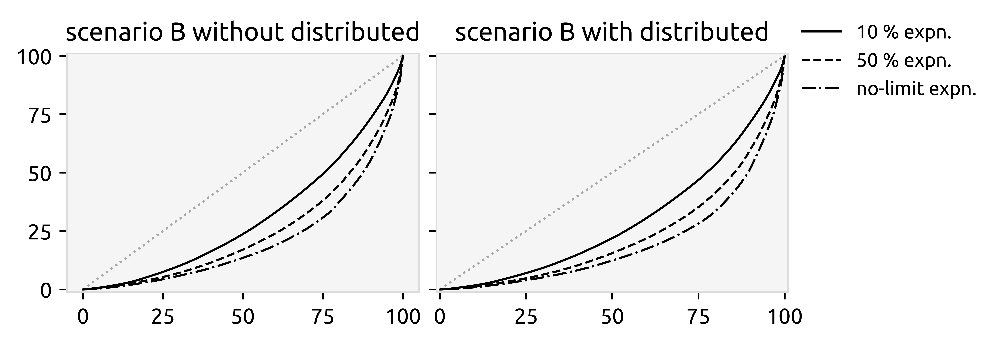

In [22]:
import cartopy.crs as ccrs
import cartopy
import geopandas as gpd

crs = ccrs.EqualEarth()
dfs={}
sortby="supply/demand"
#axins = ax.inset_axes([0.05, 0.77, 0.27, 0.23])
carriers = ["AC",]

fig, axs = plt.subplots(1,2, figsize=(6,2), sharey=True) 
plt.subplots_adjust(wspace=0.05)
plt.subplots_adjust(hspace=0.1)
plt.rc('font',family='Ubuntu')
plt.rc('axes',edgecolor='gainsboro')
plt.rcParams['figure.dpi'] = 1000

networks={'postnetworks/elec_s_181_lv{}__Co2L0p05-2H-solar+p3-dist2{}_2030.nc':['-nohomegen','']}
transmission={'1.1':['10 % expn.','solid'],'1.5':['50 % expn.','--'],'opt':['no-limit expn.','dashdot']}
linspace = np.linspace(0, 100, 100)

nice_names = {
        "AC": "electricity",
        "H2": "hydrogen",
        "gas": "methane",
        "oil": "oil",
    }

for j,network in enumerate(networks.keys()):
   for i,category in enumerate(networks[network]): 
     for tr_ex in transmission.keys():
        n=pypsa.Network(network.format(tr_ex, category))
        for c in set(carriers).difference(dfs.keys()):
            dfs[c] = None

        axs[i].plot(linspace, linspace, c="darkgrey", linestyle=":", linewidth=1)

        for carrier in carriers:
                df = cumulative_share(n, carrier, sortby, df=dfs[carrier])
                axs[i].plot(
                    df.demand,
                    df.supply,
                    label=transmission[tr_ex][0],
                    color=tech_colors[nice_names[carrier]],
                    linestyle=transmission[tr_ex][1],
                    linewidth=1,
                )
        #plt.xlabel(f"Demand [%]", fontsize=9, backgroundcolor="white", labelpad=-7)
        #plt.ylabel(f"Supply [%]", fontsize=9, backgroundcolor="white", labelpad=-10)
        plt.ylim(-1, 101)
        plt.xlim(-1, 101)
        axs[i].set_facecolor("whitesmoke")
        major = np.arange(0, 101, 50)
        #plt.xticks(major)
        #plt.yticks(major)
        #plt.tick_params(axis = 'both', which = 'major', labelsize=8)

plt.legend(fontsize=9, bbox_to_anchor=(0.99, 1.2), frameon=False)
axs[0].set_title('scenario B without distributed')
axs[1].set_title('scenario B with distributed')


#for i in ["top", "right", "left", "bottom"]:
 #       ax.spines[i].set_visible(False)
plt.show()

In [12]:
def plot_lorenz_inset(ax, n, carriers, sortby="supply/demand", dfs={}):

    networks={'postnetworks/elec_s_181_lv{}__Co2L0p05-2H-solar+p3-dist2{}_2030.nc':['-nohomegen']}  #-nohomegen
    transmission={'1.1':['10 % expn.','solid'],'1.5':['50 % expn.','--'],'opt':['no-limit expn.','dashdot']}
    for c in set(carriers).difference(dfs.keys()):
        dfs[c] = None

    linspace = np.linspace(0, 100, 100)
    ax.plot(linspace, linspace, c="darkgrey", linestyle=":", linewidth=1)

    nice_names = {
        "AC": "electricity",
        "H2": "hydrogen",
        "gas": "methane",
        "oil": "oil",
    }
    
    for j,network in enumerate(networks.keys()):
      for i,category in enumerate(networks[network]): 
         for tr_ex in transmission.keys():
            n=pypsa.Network(network.format(tr_ex, category))

            for carrier in carriers:
                    df = cumulative_share(n, carrier, sortby, df=dfs[carrier])
                    ax.plot(
                        df.demand,
                        df.supply,
                        label=transmission[tr_ex][0],
                        color=tech_colors[nice_names[carrier]],
                        linestyle=transmission[tr_ex][1],
                        linewidth=1,
                    )

    ax.set_xlabel(f"Demand [%]", fontsize=9, backgroundcolor="white", labelpad=-7)
    ax.set_ylabel(f"Supply [%]", fontsize=9, backgroundcolor="white", labelpad=-10)
    ax.set_ylim(-1, 101)
    ax.set_xlim(-1, 101)
    ax.set_facecolor("whitesmoke")
    ax.tick_params(labelsize=8)
    #ax.legend(fontsize=9, bbox_to_anchor=(0.99, 1.03), frameon=False)
    for i in ["top", "right", "left", "bottom"]:
        ax.spines[i].set_visible(False)

INFO:pypsa.io:Imported network elec_s_181_lv1.1__Co2L0p05-2H-solar+p3-dist2_2030.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


[-60. -45. -30. -15.   0.  15.  30.  45.  60.]


/tmp/ipykernel_21609/2083583315.py:54: DeprecationWarning: The outline_patch property is deprecated. Use GeoAxes.spines['geo'] or the default Axes properties instead.
  plt.gca().outline_patch.set_visible(False)
INFO:pypsa.io:Imported network elec_s_181_lv1.1__Co2L0p05-2H-solar+p3-dist2_2030.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network elec_s_181_lv1.5__Co2L0p05-2H-solar+p3-dist2_2030.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network elec_s_181_lvopt__Co2L0p05-2H-solar+p3-dist2_2030.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


Text(0.5, 1.0, 'With distributed generation\n\nScenario B')

/home/parisr/miniconda3/envs/pypsa-eur2/lib/python3.9/site-packages/cartopy/crs.py:825: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(multi_line_string) > 1:
/home/parisr/miniconda3/envs/pypsa-eur2/lib/python3.9/site-packages/cartopy/crs.py:877: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for line in multi_line_string:
/home/parisr/miniconda3/envs/pypsa-eur2/lib/python3.9/site-packages/cartopy/crs.py:944: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(p_mline) > 0:


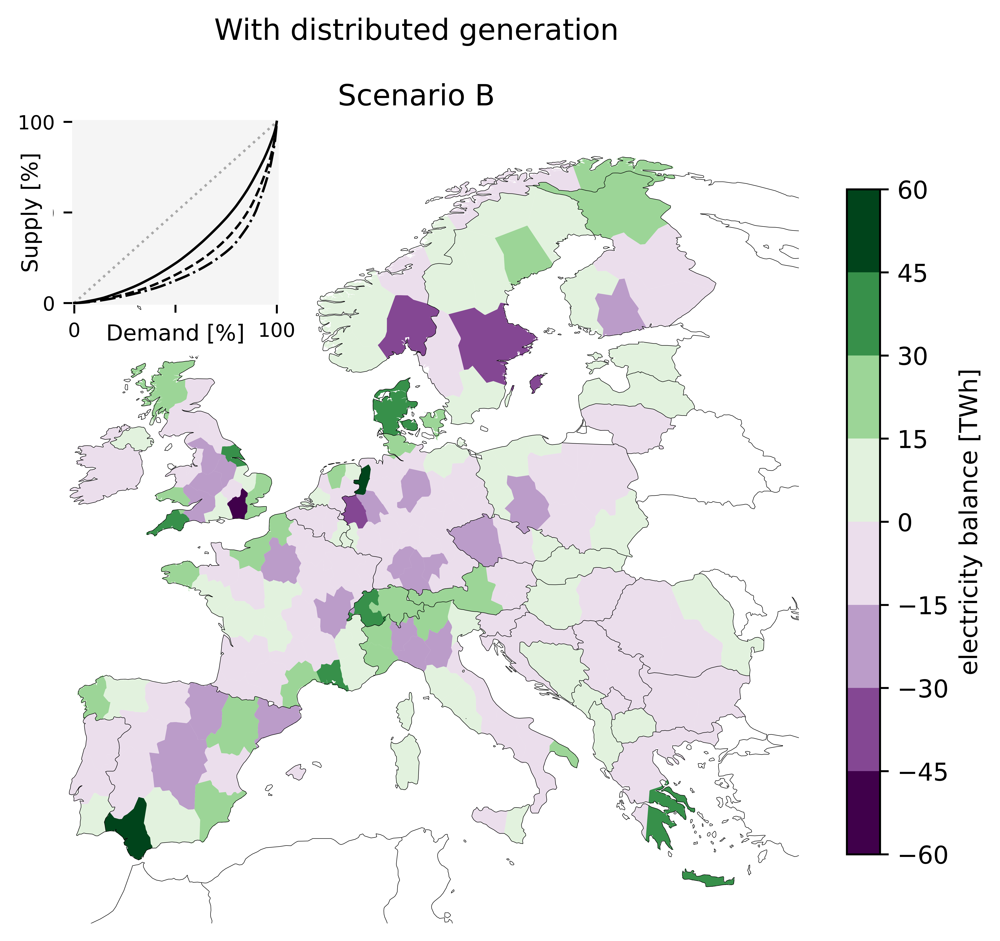

In [11]:
import cartopy.crs as ccrs
import cartopy
import geopandas as gpd
from datetime import datetime

time1=slice(datetime(2013,7,1),datetime(2013,7,2))

n=pypsa.Network('postnetworks/elec_s_181_lv1.1__Co2L0p05-2H-solar+p3-dist2_2030.nc')

#ccrs = ccrs.EqualEarth()
plt.rcParams['figure.dpi'] = 1000

proj = ccrs.EqualEarth()
nodes = gpd.read_file('regions_onshore_elec_s_181.geojson').set_index("name")
nodes = nodes.to_crs(proj.proj4_init)

io = get_import_export_balance(n) #, time=time1)

plot_import_export(io, nodes, "electricity", lim=60, cmap="PRGn", lorenz=True)  #lim=200
plt.title('With distributed generation\n\nScenario B',)

In [209]:
#figure 2
#rooftop capacity(opy)7potential (max) vs. el. demand

fig, axs = plt.subplots(1,2,figsize=(30, 30), subplot_kw={"projection": proj})
proj = ccrs.EqualEarth()
geodf = gpd.read_file('regions_onshore_elec_s_181.geojson').set_index("name")

geodf = geodf.to_crs(proj.proj4_init)


s=(pd.Series((n.generators.p_nom_max.groupby([ n.generators.carrier , n.generators.bus.map(n.buses.location)])
   .sum()['solar rooftop']),geodf.index).fillna(0))

geodf.plot(
        ax=axs[0],
        column=s,
        # transform=ccrs.PlateCarree(),
        cmap="Oranges",
        alpha=1,
        linewidths=0,
        vmax=s.max(),
        legend=True,
        legend_kwds={"label": 'Solar rooftop max capacity', "shrink": 0.7, "extend": "max"},
        
    )

geodf.plot(
        ax=axs[1],
        column=demand_by_region.filter(regex=regex['electricity']).sum(axis=1) ,
        # transform=ccrs.PlateCarree(),
        cmap=cmap['electricity'],
        alpha=1,
        linewidths=0,
        vmax=demand_by_region.filter(regex=regex['electricity']).sum(axis=1).max(),
        legend=True,
        legend_kwds={"label": title['electricity'], "shrink": 0.7, "extend": "max"},
        
    )
for ax in axs :
 ax.add_feature(cartopy.feature.COASTLINE.with_scale("50m"), linewidth=0.2, zorder=2)
 ax.add_feature(cartopy.feature.BORDERS.with_scale("50m"), linewidth=0.2, zorder=2)

/home/parisr/miniconda3/envs/pypsa-eur2/lib/python3.9/site-packages/cartopy/crs.py:825: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(multi_line_string) > 1:
/home/parisr/miniconda3/envs/pypsa-eur2/lib/python3.9/site-packages/cartopy/crs.py:877: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for line in multi_line_string:
/home/parisr/miniconda3/envs/pypsa-eur2/lib/python3.9/site-packages/cartopy/crs.py:944: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(p_mline) > 0:


In [7]:
# figure S9
import matplotlib.dates as mdates

fig, axs = plt.subplots(2,2, figsize=(12,8), sharey=True) 
plt.subplots_adjust(wspace=0.05)
plt.subplots_adjust(hspace=0.1)

s=[194*12, 14*12]
e=[201*12, 21*12]

plt.rc('font',family='Ubuntu')
plt.rc('axes',edgecolor='gainsboro')
plt.rcParams['figure.dpi'] = 1000

networks={'postnetworks/elec_s_181_lv1.1__Co2L0p05-2H-solar+p3-dist1-nohomegen-higheff_2030.nc':'Without distributed generation',
          'postnetworks/elec_s_181_lv1.1__Co2L0p05-2H-solar+p3-dist1-higheff_2030.nc':'With distributed generation',}
date_form = mdates.DateFormatter('%m-%d')

country='DE'  #'IT' , ' '

for i,network in enumerate(networks.keys()):
  n=pypsa.Network(network)
  for j,season in enumerate(['summer week','winter week']):
    energy_production, colors=get_energy_production(n, s[j] , e[j], 'all', [], country)  
    energy_usage, colors_2=get_energy_usage(n, s[j] , e[j], 'all', [], country)  
    colors.extend(colors_2)
    
    axs[i,j].set_prop_cycle(color=colors)
    #seperate battery and home battery
    axs[i,j].stackplot(n.snapshots[s[j]:e[j]],energy_production.values(),
                       labels=energy_production.keys())   #GWh
    axs[i,j].stackplot(n.snapshots[s[j]:e[j]],energy_usage.values(),
                       labels=energy_usage.keys())
    axs[i,j].plot(2*n.loads_t.p.filter(like=country).sum(axis=1)[s[j]:e[j]]/1e3,
                  color='black'
                 ,label='electricity demand'
                 ,linewidth=3)
    hightolow=2*((-1)*n.links_t.p1.filter(like=country).filter(like='distribution grid')
              [n.links_t.p1.filter(like=country).filter(like='distribution grid')<0])[s[j]:e[j]].sum(axis=1)/1e3
    axs[i,j].plot(hightolow,
                  color='red',
                  label= 'LV electricity demand',
                  linewidth=3)
    axs[i,j].fill_between(n.snapshots[s[j]:e[j]], 0, hightolow, 
                          facecolor='grey', 
                          interpolate=True, 
                          alpha=.7)
    axs[i,j].tick_params(axis='y', labelsize=20)
    if i==0 :axs[i,j].set_xticks([], []) 
    if i==1 :
        axs[i,j].xaxis.set_major_locator(mdates.DayLocator(interval=1))
        axs[i,j].xaxis.set_major_formatter(date_form)
        for label in axs[i,j].get_xticklabels(which='major'):
            label.set(rotation=45, fontsize= 16, rotation_mode='anchor',ha='right')
        axs[i,j].set_xlabel("\ndays",fontsize= 18)
    if i==0: axs[i,j].set_title(season+'\n', fontsize=18)
    if j==0: axs[i,j].set_ylabel(networks[network]+'\n\n'+'Energy generation [GWh]',fontsize=14, 
                                 fontname = 'Ubuntu',labelpad=10)
    handles, labels = axs[i,j].get_legend_handles_labels()


#
plt.legend(handles[::-1], labels[::-1], loc='upper left', bbox_to_anchor=(1, 2),ncol=1,
           fontsize=12,frameon=False)   



fig.text(0, 0.4, "Scenario A\n", 
         fontsize=14, rotation=90, rotation_mode='anchor')

#plt.savefig('figure 5b.pdf', dpi=1000)

INFO:pypsa.io:Imported network elec_s_181_lv1.1__Co2L0p05-2H-solar+p3-dist1-nohomegen-higheff_2030.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network elec_s_181_lv1.1__Co2L0p05-2H-solar+p3-dist1-higheff_2030.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


Text(0, 0.4, 'Scenario A\n')

INFO:pypsa.io:Imported network elec_s_181_lv1.1__Co2L0p05-2H-T-H-B-I-solar+p3-dist2-noH2network-nohomegen_2030.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network elec_s_181_lv1.1__Co2L0p05-2H-T-H-B-I-solar+p3-dist2-noH2network_2030.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


Text(0, 0.4, 'Scenario C\n')

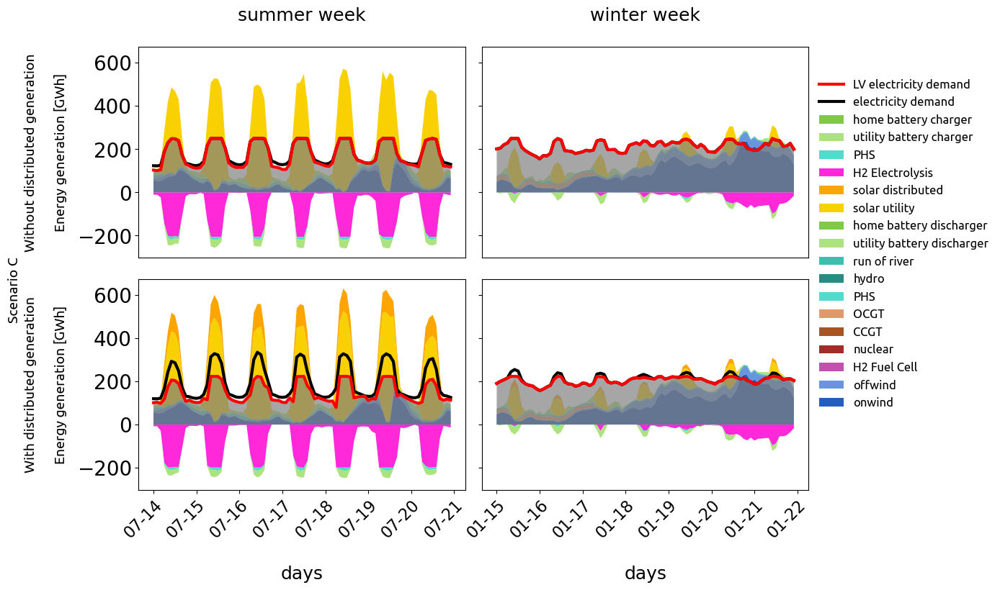

In [6]:
# figure S11
import matplotlib.dates as mdates

fig, axs = plt.subplots(2,2, figsize=(12,8), sharey=True) 
plt.subplots_adjust(wspace=0.05)
plt.subplots_adjust(hspace=0.1)

s=[194*12, 14*12]
e=[201*12, 21*12]

plt.rc('font',family='Ubuntu')
plt.rc('axes',edgecolor='gainsboro')
plt.rcParams['figure.dpi'] = 1000

networks={'../Stable-sector-coupled/postnetworks/elec_s_181_lv1.1__Co2L0p05-2H-T-H-B-I-solar+p3-dist2-noH2network-nohomegen_2030.nc':'Without distributed generation',
          '../Stable-sector-coupled/postnetworks/elec_s_181_lv1.1__Co2L0p05-2H-T-H-B-I-solar+p3-dist2-noH2network_2030.nc':'With distributed generation',}
date_form = mdates.DateFormatter('%m-%d')

country='DE'  #'IT' , ' '

for i,network in enumerate(networks.keys()):
  n=pypsa.Network(network)
  for j,season in enumerate(['summer week','winter week']):
    energy_production, colors=get_energy_production(n, s[j] , e[j], 'all', [], country)  
    energy_usage, colors_2=get_energy_usage(n, s[j] , e[j], 'all', [], country)  
    colors.extend(colors_2)
    
    axs[i,j].set_prop_cycle(color=colors)
    #seperate battery and home battery
    axs[i,j].stackplot(n.snapshots[s[j]:e[j]],energy_production.values(),
                       labels=energy_production.keys())   #GWh
    axs[i,j].stackplot(n.snapshots[s[j]:e[j]],energy_usage.values(),
                       labels=energy_usage.keys())
    elec_load = (n.loads_t.p[[i for i in n.loads.index if 'electricity' in n.loads.carrier[i]]].filter(like=country).sum(axis=1)+
             n.links_t.p0.filter(like='heat pump').filter(like=country).sum(axis=1)+
              n.links_t.p0.filter(like='BEV').filter(like=country).sum(axis=1)+
              n.links_t.p0.filter(like='resistive heater').filter(like=country).sum(axis=1))[s[j]:e[j]]
    axs[i,j].plot(2*elec_load/1e3,
                  color='black'
                 ,label='electricity demand'
                 ,linewidth=3)
    hightolow=2*((-1)*n.links_t.p1.filter(like=country).filter(like='distribution grid')
              [n.links_t.p1.filter(like=country).filter(like='distribution grid')<0])[s[j]:e[j]].sum(axis=1)/1e3
    axs[i,j].plot(hightolow,
                  color='red',
                  label= 'LV electricity demand',
                  linewidth=3)
    axs[i,j].fill_between(n.snapshots[s[j]:e[j]], 0, hightolow, 
                          facecolor='grey', 
                          interpolate=True, 
                          alpha=.7)
    axs[i,j].tick_params(axis='y', labelsize=20)
    if i==0 :axs[i,j].set_xticks([], []) 
    if i==1 :
        axs[i,j].xaxis.set_major_locator(mdates.DayLocator(interval=1))
        axs[i,j].xaxis.set_major_formatter(date_form)
        for label in axs[i,j].get_xticklabels(which='major'):
            label.set(rotation=45, fontsize= 16, rotation_mode='anchor',ha='right')
        axs[i,j].set_xlabel("\ndays",fontsize= 18)
    if i==0: axs[i,j].set_title(season+'\n', fontsize=18)
    if j==0: axs[i,j].set_ylabel(networks[network]+'\n\n'+'Energy generation [GWh]',fontsize=14, 
                                 fontname = 'Ubuntu',labelpad=10)
    handles, labels = axs[i,j].get_legend_handles_labels()


#
plt.legend(handles[::-1], labels[::-1], loc='upper left', bbox_to_anchor=(1, 2),ncol=1,
           fontsize=12,frameon=False)   


fig.text(0, 0.4, "Scenario C\n", 
         fontsize=14, rotation=90, rotation_mode='anchor')

#plt.savefig('figure 5b.pdf', dpi=1000)